# Practicum II - Using News Headlines to Predict Stock Market Performance - Data Cleaning/Preparation

To start this project off, I need to read in all of my data and begin cleaning and preparing it for future analysis. Let's get started on this by first loading the necessary packages and then reading in and viewing a few records from each dataset:

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.probability import FreqDist
import string

In [2]:
DJIA_df = pd.read_csv("data/DJIA_table.csv")
headlines_df = pd.read_csv("data/RedditNews.csv")
combined_df = pd.read_csv("data/Combined_News_DJIA.csv")

In [3]:
display(DJIA_df.head())

,Date,Open,High,Low,Close,Volume,Adj Close
0,2016-07-01,17924.240234,18002.380859,17916.910156,17949.369141,82160000,17949.369141
1,2016-06-30,17712.759766,17930.609375,17711.800781,17929.990234,133030000,17929.990234
2,2016-06-29,17456.019531,17704.509766,17456.019531,17694.679688,106380000,17694.679688
3,2016-06-28,17190.509766,17409.720703,17190.509766,17409.720703,112190000,17409.720703
4,2016-06-27,17355.210938,17355.210938,17063.080078,17140.240234,138740000,17140.240234


In [4]:
display(headlines_df.head())

,Date,News
0,2016-07-01,A 117-year-old woman in Mexico City finally re...
1,2016-07-01,IMF chief backs Athens as permanent Olympic host
2,2016-07-01,"The president of France says if Brexit won, so..."
3,2016-07-01,British Man Who Must Give Police 24 Hours' Not...
4,2016-07-01,100+ Nobel laureates urge Greenpeace to stop o...


In [5]:
display(combined_df.head())

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16,Top17,Top18,Top19,Top20,Top21,Top22,Top23,Top24,Top25
0,2008-08-08,0,"b""Georgia 'downs two Russian warplanes' as cou...",b'BREAKING: Musharraf to be impeached.',b'Russia Today: Columns of troops roll into So...,b'Russian tanks are moving towards the capital...,"b""Afghan children raped with 'impunity,' U.N. ...",b'150 Russian tanks have entered South Ossetia...,"b""Breaking: Georgia invades South Ossetia, Rus...","b""The 'enemy combatent' trials are nothing but...",...,b'Georgia Invades South Ossetia - if Russia ge...,b'Al-Qaeda Faces Islamist Backlash',"b'Condoleezza Rice: ""The US would not act to p...",b'This is a busy day: The European Union has ...,"b""Georgia will withdraw 1,000 soldiers from Ir...",b'Why the Pentagon Thinks Attacking Iran is a ...,b'Caucasus in crisis: Georgia invades South Os...,b'Indian shoe manufactory - And again in a se...,b'Visitors Suffering from Mental Illnesses Ban...,"b""No Help for Mexico's Kidnapping Surge"""
1,2008-08-11,1,b'Why wont America and Nato help us? If they w...,b'Bush puts foot down on Georgian conflict',"b""Jewish Georgian minister: Thanks to Israeli ...",b'Georgian army flees in disarray as Russians ...,"b""Olympic opening ceremony fireworks 'faked'""",b'What were the Mossad with fraudulent New Zea...,b'Russia angered by Israeli military sale to G...,b'An American citizen living in S.Ossetia blam...,...,b'Israel and the US behind the Georgian aggres...,"b'""Do not believe TV, neither Russian nor Geor...",b'Riots are still going on in Montreal (Canada...,b'China to overtake US as largest manufacturer',b'War in South Ossetia [PICS]',b'Israeli Physicians Group Condemns State Tort...,b' Russia has just beaten the United States ov...,b'Perhaps *the* question about the Georgia - R...,b'Russia is so much better at war',"b""So this is what it's come to: trading sex fo..."
2,2008-08-12,0,b'Remember that adorable 9-year-old who sang a...,"b""Russia 'ends Georgia operation'""","b'""If we had no sexual harassment we would hav...","b""Al-Qa'eda is losing support in Iraq because ...",b'Ceasefire in Georgia: Putin Outmaneuvers the...,b'Why Microsoft and Intel tried to kill the XO...,b'Stratfor: The Russo-Georgian War and the Bal...,"b""I'm Trying to Get a Sense of This Whole Geor...",...,b'U.S. troops still in Georgia (did you know t...,b'Why Russias response to Georgia was right',"b'Gorbachev accuses U.S. of making a ""serious ...","b'Russia, Georgia, and NATO: Cold War Two'",b'Remember that adorable 62-year-old who led y...,b'War in Georgia: The Israeli connection',b'All signs point to the US encouraging Georgi...,b'Christopher King argues that the US and NATO...,b'America: The New Mexico?',"b""BBC NEWS | Asia-Pacific | Extinction 'by man..."
3,2008-08-13,0,b' U.S. refuses Israel weapons to attack Iran:...,"b""When the president ordered to attack Tskhinv...",b' Israel clears troops who killed Reuters cam...,b'Britain\'s policy of being tough on drugs is...,b'Body of 14 year old found in trunk; Latest (...,b'China has moved 10 *million* quake survivors...,"b""Bush announces Operation Get All Up In Russi...",b'Russian forces sink Georgian ships ',...,b'Elephants extinct by 2020?',b'US humanitarian missions soon in Georgia - i...,"b""Georgia's DDOS came from US sources""","b'Russian convoy heads into Georgia, violating...",b'Israeli defence minister: US against strike ...,b'Gorbachev: We Had No Choice',b'Witness: Russian forces head towards Tbilisi...,b' Quarter of Russians blame U.S. for conflict...,b'Georgian president says US military will ta...,b'2006: Nobel laureate Aleksander Solzhenitsyn...
4,2008-08-14,1,b'All the experts admit that we should legalis...,b'War in South Osetia - 89 pictures made by a ...,b'Swedish wrestler Ara Abrahamian throws away ...,b'Russia exaggerated the death toll in South O...,b'Missile That Killed 9 Inside Pakistan May Ha...,"b""Rushdie Condemns Random House's Refusal to P...",b'Poland and US agree 

In [6]:
display(combined_df.tail())

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16,Top17,Top18,Top19,Top20,Top21,Top22,Top23,Top24,Top25
1984,2016-06-27,0,Barclays and RBS shares suspended from trading...,Pope says Church should ask forgiveness from g...,Poland 'shocked' by xenophobic abuse of Poles ...,"There will be no second referendum, cabinet ag...","Scotland welcome to join EU, Merkel ally says",Sterling dips below Friday's 31-year low amid ...,No negative news about South African President...,Surge in Hate Crimes in the U.K. Following U.K...,...,German lawyers to probe Erdogan over alleged w...,"Boris Johnson says the UK will continue to ""in...",Richard Branson is calling on the UK governmen...,Turkey 'sorry for downing Russian jet',Edward Snowden lawyer vows new push for pardon...,Brexit opinion poll reveals majority don't wan...,"Conservative MP Leave Campaigner: ""The leave c...","Economists predict UK recession, further weake...","New EU 'superstate plan by France, Germany: Cr...",Pakistani clerics declare transgender marriage...
1985,2016-06-28,1,"2,500 Scientists To Australia: If You Want To ...","The personal details of 112,000 French police ...",S&amp;P cuts United Kingdom sovereign credit r...,Huge helium deposit found in Africa,CEO of the South African state broadcaster qui...,"Brexit cost investors $2 trillion, the worst o...",Hong Kong democracy activists call for return ...,Brexit: Iceland president says UK can join 'tr...,...,"US, Canada and Mexico pledge 50% of power from...",There is increasing evidence that Australia is...,"Richard Branson, the founder of Virgin Group, ...","37,000-yr-old skull from Borneo reveals surpri...",Palestinians stone Western Wall worshipers; po...,Jean-Claude Juncker asks Farage: Why are you h...,"""Romanians for Remainians"" offering a new home...",Brexit: Gibraltar in talks with Scotland to st...,8 Suicide Bombers Strike Lebanon,Mexico's security forces routinely use 'sexual...
1986,2016-06-29,1,Explosion At Airport In Istanbul,Yemeni former president: Terrorism is the offs...,UK must accept freedom of movement to access E...,Devastated: scientists too late to captive bre...,British Labor Party leader Jeremy Corbyn loses...,A Muslim Shop in the UK Was Just Firebombed Wh...,Mexican Authorities Sexually Torture Women in ...,UK shares and pound continue to recover,...,"Escape Tunnel, Dug by Hand, Is Found at Holoca...",The land under Beijing is sinking by as much a...,Car bomb and Anti-Islamic attack on Mosque in ...,Emaciated lions in Taiz Zoo are trapped in blo...,Rupert Murdoch describes Brexit as 'wonderful'...,More than 40 killed in Yemen suicide attacks,Google Found Disastrous Symantec and Norton Vu...,Extremist violence on the rise in Germany: Dom...,BBC News: Labour MPs pass Corbyn no-confidence...,Tiny New Zealand town with 'too many jobs' lau...
1987,2016-06-30,1,Jamaica proposes marijuana dispensers for tour...,Stephen Hawking says pollution and 'stupidity'...,Boris Johnson says he will not run for Tory pa...,Six gay men in Ivory Coast were abused and for...,Switzerland denies citizenship to Muslim immig...,Palestinian terrorist stabs israeli teen girl ...,Puerto Rico will default on $1 billion of debt...,Republic of Ireland fans to be awarded medal f...,...,Googles free wifi at Indian railway stations i...,Mounting evidence suggests 'hobbits' were wipe...,The men who carried out Tuesday's terror attac...,Calls to suspend Saudi Arabia from UN Human Ri...,More Than 100 Nobel Laureates Call Out Greenpe...,British pedophile sentenced to 85 years in US ...,"US permitted 1,200 offshore fracks in Gulf of ...",We will be swimming in ridicule - French beach...,UEFA says no minutes of silence for Istanbul v...,Law Enforcement Sources: Gun Used in Paris Ter...
1988,2016-07-01,1,A 117-year-old woman in Mexico City finally re...,IMF chief backs Athens as permanent Olympic host,"The president of France says if Brexit won, so...",British Man Who Must Give Police 24 Hours' Not...,100+ Nobel laureates 

From viewing the first few records of each dataset, I can tell that all datasets contain a date column. In the Dow Jones Industrial Average (DJIA) dataset there are columns indicating stock performance on each day including the opening price, daily low, daily high, the closing price, the overall volume of trades made on that day, and an adjusted close column. I'm not sure what the difference between the closing value and the adjusted closing value would be, so this is something I'll need to investigate further down the line. As for the news headlines dataset, aside from date all this really has are the raw news headlines from each date, but with no indication of the relative popularity of each of these headlines. As for the combined dataset, on the other hand, there are the top 25 news headlines ranked in order of popularity from `Top1` to `Top25`, making this dataset a bit more useful for obtaining my news headlines in a structred way where I can compare relative popularity, and it also contains a binary column indicating whether or not the stocks rose (1) or fell (0) on that particular date. This combined dataset is noticably lacking any other stock market statistics, though, so I will still need to use the DJIA dataset in order to obtain this information. 

Something I'm noticing in row 1988 in the combined dataset is that in the `Top17` column, S&P has the ampersand (&) HTML encoded as `&amp;`. This is something I need to address in my cleaning down the line because I know I'll be doing something about punctuation, but I don't want to change the semantic meaning of S&P by making it `SampP` or by separating the `S` and `P` into separate words. Noted.

In order to better familiarize myself with this data, the first thing I want to do is create a quick visualization of each of the columns from the DJIA dataset to get a visual depiction of the data. In order to see these plots in this notebook, I'll need to use the `%matplotlib inline` magic. Let's do that now:

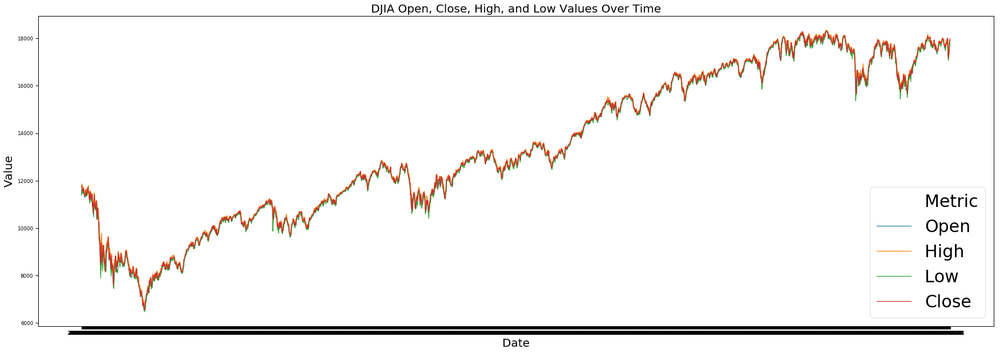

In [7]:
# set the seaborn context so that labels and font are larger
sns.set_context("paper", rc={"font.size":40,"axes.titlesize":20,"axes.labelsize":20})
# Make figure size larger so can see details
plt.figure(figsize=(30, 10))
# grab columns I want to graph (volumn on different scale so not including, still not sure what adjusted close is)
temp = DJIA_df[["Date", "Open", "High", "Low", "Close"]]
# convert to long format for plotting
temp = temp.melt('Date', var_name = 'Metric', value_name = "Value")
# plot multiple lines using the column names as the coloring factor
sns.lineplot(x = "Date", y = 'Value', hue = 'Metric', data = temp)
plt.title("DJIA Open, Close, High, and Low Values Over Time")
# have legend show in lower right since no data there and make font larger since larger plot
plt.legend(loc = "lower right", fontsize = 30)
plt.savefig("visualizations/lineplots/stocks_value_plot.png")

Very cool! It's hard to tell the different lines apart because of the scale of the chart, but something that stands out to me is that the lows oftentimes dip much lower than any other value on a given day, and this pattern isn't necessarily seen with the daily highs. This tells me that the stock market is much more likely to recover from a low in a day than it is to drop from a high in a day. I have no clue why this might be, but it's certainly fascinating!

Now that I've gotten a brief look at my data, it's time to start cleaning it up. The first thing I want to do is get rid of all the special characters and strange artifacts in the news headlines. Some of these headlines appear to have been saved as bitstrings before as they are prefixed with `b'` or `b"` and then end with `'` or `"`. I'll start with getting rid of these by removing all `b'` or `b"` from the start of any headline and any `'` or `"` that ends a headline:

In [8]:
# compile regex since will be applying to multiple columns
bitstr_artifacts = re.compile(r"""^b'|^b"|"$|'$""")
# replace all instances of bitstring artifacts from headline columns in combined dataframe
for col in list(combined_df.columns)[2:]:
    combined_df[col] = combined_df[col].str.replace(bitstr_artifacts, '')

In [9]:
display(combined_df.tail())

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16,Top17,Top18,Top19,Top20,Top21,Top22,Top23,Top24,Top25
1984,2016-06-27,0,Barclays and RBS shares suspended from trading...,Pope says Church should ask forgiveness from g...,Poland 'shocked' by xenophobic abuse of Poles ...,"There will be no second referendum, cabinet ag...","Scotland welcome to join EU, Merkel ally says",Sterling dips below Friday's 31-year low amid ...,No negative news about South African President...,Surge in Hate Crimes in the U.K. Following U.K...,...,German lawyers to probe Erdogan over alleged w...,"Boris Johnson says the UK will continue to ""in...",Richard Branson is calling on the UK governmen...,Turkey 'sorry for downing Russian jet,Edward Snowden lawyer vows new push for pardon...,Brexit opinion poll reveals majority don't wan...,"Conservative MP Leave Campaigner: ""The leave c...","Economists predict UK recession, further weake...","New EU 'superstate plan by France, Germany: Cr...",Pakistani clerics declare transgender marriage...
1985,2016-06-28,1,"2,500 Scientists To Australia: If You Want To ...","The personal details of 112,000 French police ...",S&amp;P cuts United Kingdom sovereign credit r...,Huge helium deposit found in Africa,CEO of the South African state broadcaster qui...,"Brexit cost investors $2 trillion, the worst o...",Hong Kong democracy activists call for return ...,Brexit: Iceland president says UK can join 'tr...,...,"US, Canada and Mexico pledge 50% of power from...",There is increasing evidence that Australia is...,"Richard Branson, the founder of Virgin Group, ...","37,000-yr-old skull from Borneo reveals surpri...",Palestinians stone Western Wall worshipers; po...,Jean-Claude Juncker asks Farage: Why are you h...,"""Romanians for Remainians"" offering a new home...",Brexit: Gibraltar in talks with Scotland to st...,8 Suicide Bombers Strike Lebanon,Mexico's security forces routinely use 'sexual...
1986,2016-06-29,1,Explosion At Airport In Istanbul,Yemeni former president: Terrorism is the offs...,UK must accept freedom of movement to access E...,Devastated: scientists too late to captive bre...,British Labor Party leader Jeremy Corbyn loses...,A Muslim Shop in the UK Was Just Firebombed Wh...,Mexican Authorities Sexually Torture Women in ...,UK shares and pound continue to recover,...,"Escape Tunnel, Dug by Hand, Is Found at Holoca...",The land under Beijing is sinking by as much a...,Car bomb and Anti-Islamic attack on Mosque in ...,Emaciated lions in Taiz Zoo are trapped in blo...,Rupert Murdoch describes Brexit as 'wonderful'...,More than 40 killed in Yemen suicide attacks,Google Found Disastrous Symantec and Norton Vu...,Extremist violence on the rise in Germany: Dom...,BBC News: Labour MPs pass Corbyn no-confidence...,Tiny New Zealand town with 'too many jobs' lau...
1987,2016-06-30,1,Jamaica proposes marijuana dispensers for tour...,Stephen Hawking says pollution and 'stupidity'...,Boris Johnson says he will not run for Tory pa...,Six gay men in Ivory Coast were abused and for...,Switzerland denies citizenship to Muslim immig...,Palestinian terrorist stabs israeli teen girl ...,Puerto Rico will default on $1 billion of debt...,Republic of Ireland fans to be awarded medal f...,...,Googles free wifi at Indian railway stations i...,Mounting evidence suggests 'hobbits' were wipe...,The men who carried out Tuesday's terror attac...,Calls to suspend Saudi Arabia from UN Human Ri...,More Than 100 Nobel Laureates Call Out Greenpe...,British pedophile sentenced to 85 years in US ...,"US permitted 1,200 offshore fracks in Gulf of ...",We will be swimming in ridicule - French beach...,UEFA says no minutes of silence for Istanbul v...,Law Enforcement Sources: Gun Used in Paris Ter...
1988,2016-07-01,1,A 117-year-old woman in Mexico City finally re...,IMF chief backs Athens as permanent Olympic host,"The president of France says if Brexit won, so...",British Man Who Must Give Police 24 Hours' Not...,100+ Nobel laureates u

Awesome, looks to have done exactly what I wanted it to! Now before removing all other special character artifacts, let's see what we end up with when we tokenize the data as is. To do this, I'll apply this to the `headlines_df` so that I don't have to worry about the mutliple columns of the `combined_df` until I decide if I need to further clean the data before tokenizing:

In [10]:
# NOTE: I downloaded all nltk packages via nltk.download()
headlines_df['News'] = headlines_df['News'].str.replace(bitstr_artifacts, '')
headlines_df['tokenized'] = headlines_df['News'].apply(word_tokenize)
headlines_df.head()

,Date,News,tokenized
0,2016-07-01,A 117-year-old woman in Mexico City finally re...,"[A, 117-year-old, woman, in, Mexico, City, fin..."
1,2016-07-01,IMF chief backs Athens as permanent Olympic host,"[IMF, chief, backs, Athens, as, permanent, Oly..."
2,2016-07-01,"The president of France says if Brexit won, so...","[The, president, of, France, says, if, Brexit,..."
3,2016-07-01,British Man Who Must Give Police 24 Hours' Not...,"[British, Man, Who, Must, Give, Police, 24, Ho..."
4,2016-07-01,100+ Nobel laureates urge Greenpeace to stop o...,"[100+, Nobel, laureates, urge, Greenpeace, to,..."


In [11]:
headlines_df.tail()

,Date,News,tokenized
73603,2008-06-08,Man goes berzerk in Akihabara and stabs everyo...,"[Man, goes, berzerk, in, Akihabara, and, stabs..."
73604,2008-06-08,Threat of world AIDS pandemic among heterosexu...,"[Threat, of, world, AIDS, pandemic, among, het..."
73605,2008-06-08,Angst in Ankara: Turkey Steers into a Dangerou...,"[Angst, in, Ankara, :, Turkey, Steers, into, a..."
73606,2008-06-08,UK: Identity cards 'could be used to spy on pe...,"[UK, :, Identity, cards, 'could, be, used, to,..."
73607,2008-06-08,"Marriage, they said, was reduced to the status...","[Marriage, ,, they, said, ,, was, reduced, to,..."


From the outputs above, it looks like in some cases special characters are considered to be their own token (i.e. `,` and `:` in the last output) while others are considered part of the word (i.e. `-` and `+` in the first output). This might be problematic for me as I don't want `'could` and `could` showing as different words in my final analyses, so I will simply remove all punctuation from the data, with the exception that I will replace hyphens with spaces so as to separate hyphenated words and I will replace the `&amp;` ampersand encoding with the word `and` to maintain the semantic meaning. Let's see how this looks:

In [12]:
# saw instance of & in S&P encoded as &amp; in last row of combined_df.tail(), replace with and to maintain semantic
headlines_df['News'] = headlines_df['News'].str.replace("&amp;", "and")
# replace hyphens with blank space. Don't want to combine hyphenations into single word as more meaninful as separate words
headlines_df['News'] = headlines_df['News'].str.replace("-", " ")
# replace all punctuation with blank space
headlines_df['News'] = headlines_df['News'].str.replace(rf'[{string.punctuation}]', "")
headlines_df['tokenized'] = headlines_df['News'].apply(word_tokenize)
headlines_df.head()

,Date,News,tokenized
0,2016-07-01,A 117 year old woman in Mexico City finally re...,"[A, 117, year, old, woman, in, Mexico, City, f..."
1,2016-07-01,IMF chief backs Athens as permanent Olympic host,"[IMF, chief, backs, Athens, as, permanent, Oly..."
2,2016-07-01,The president of France says if Brexit won so ...,"[The, president, of, France, says, if, Brexit,..."
3,2016-07-01,British Man Who Must Give Police 24 Hours Noti...,"[British, Man, Who, Must, Give, Police, 24, Ho..."
4,2016-07-01,100 Nobel laureates urge Greenpeace to stop op...,"[100, Nobel, laureates, urge, Greenpeace, to, ..."


In [13]:
headlines_df.tail()

,Date,News,tokenized
73603,2008-06-08,Man goes berzerk in Akihabara and stabs everyo...,"[Man, goes, berzerk, in, Akihabara, and, stabs..."
73604,2008-06-08,Threat of world AIDS pandemic among heterosexu...,"[Threat, of, world, AIDS, pandemic, among, het..."
73605,2008-06-08,Angst in Ankara Turkey Steers into a Dangerous...,"[Angst, in, Ankara, Turkey, Steers, into, a, D..."
73606,2008-06-08,UK Identity cards could be used to spy on peop...,"[UK, Identity, cards, could, be, used, to, spy..."
73607,2008-06-08,Marriage they said was reduced to the status o...,"[Marriage, they, said, was, reduced, to, the, ..."


This seems to have worked well at removing instances of special characters! Let's take a look at one whole day and see if everything looks right:

In [14]:
headlines_df[headlines_df['Date'] == '2016-07-01']

,Date,News,tokenized
0,2016-07-01,A 117 year old woman in Mexico City finally re...,"[A, 117, year, old, woman, in, Mexico, City, f..."
1,2016-07-01,IMF chief backs Athens as permanent Olympic host,"[IMF, chief, backs, Athens, as, permanent, Oly..."
2,2016-07-01,The president of France says if Brexit won so ...,"[The, president, of, France, says, if, Brexit,..."
3,2016-07-01,British Man Who Must Give Police 24 Hours Noti...,"[British, Man, Who, Must, Give, Police, 24, Ho..."
4,2016-07-01,100 Nobel laureates urge Greenpeace to stop op...,"[100, Nobel, laureates, urge, Greenpeace, to, ..."
5,2016-07-01,Brazil Huge spike in number of police killings...,"[Brazil, Huge, spike, in, number, of, police, ..."
6,2016-07-01,Austrias highest court annuls presidential ele...,"[Austrias, highest, court, annuls, presidentia..."
7,2016-07-01,Facebook wins privacy case can track any Belgi...,"[Facebook, wins, privacy, case, can, track, an..."
8,2016-07-01,Switzerland denies Muslim girls citizenship af...,"[Switzerland, denies, Muslim, girls, citizensh..."
9,2016-07-01,China kills millions of innocent meditators fo...,"[China, kills, millions, of, innocent, meditat..."


This looks great! Let's go ahead and apply this to the `combined_df` headline columns. For the tokenizing aspect, I'll create a new tokenized column for each of the `Top##` columns:

In [15]:
for col in list(combined_df.columns)[2:]:
    # convert columns to str b/c Top23 apparently has byte like object
    combined_df[col] = combined_df[col].astype(str)
    # saw instance of & in S&P encoded as &amp; in last row of combined_df.tail(), replace with and to maintain semantic
    combined_df[col] = combined_df[col].str.replace("&amp;", "and")
    # replace hyphens with blank space. Don't want to combine hyphenations into single word as more meaninful as separate words
    combined_df[col] = combined_df[col].str.replace("-", " ")
    # replace all punctuation with blank space
    combined_df[col] = combined_df[col].str.replace(rf'[{string.punctuation}]', "")
    combined_df[col + '_tokenized'] = combined_df[col].apply(word_tokenize)
combined_df.head()

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16_tokenized,Top17_tokenized,Top18_tokenized,Top19_tokenized,Top20_tokenized,Top21_tokenized,Top22_tokenized,Top23_tokenized,Top24_tokenized,Top25_tokenized
0,2008-08-08,0,Georgia downs two Russian warplanes as countri...,BREAKING Musharraf to be impeached,Russia Today Columns of troops roll into South...,Russian tanks are moving towards the capital o...,Afghan children raped with impunity UN officia...,150 Russian tanks have entered South Ossetia w...,Breaking Georgia invades South Ossetia Russia ...,The enemy combatent trials are nothing but a s...,...,"[Georgia, Invades, South, Ossetia, if, Russia,...","[Al, Qaeda, Faces, Islamist, Backlash]","[Condoleezza, Rice, The, US, would, not, act, ...","[This, is, a, busy, day, The, European, Union,...","[Georgia, will, withdraw, 1000, soldiers, from...","[Why, the, Pentagon, Thinks, Attacking, Iran, ...","[Caucasus, in, crisis, Georgia, invades, South...","[Indian, shoe, manufactory, And, again, in, a,...","[Visitors, Suffering, from, Mental, Illnesses,...","[No, Help, for, Mexicos, Kidnapping, Surge]"
1,2008-08-11,1,Why wont America and Nato help us If they wont...,Bush puts foot down on Georgian conflict,Jewish Georgian minister Thanks to Israeli tra...,Georgian army flees in disarray as Russians ad...,Olympic opening ceremony fireworks faked,What were the Mossad with fraudulent New Zeala...,Russia angered by Israeli military sale to Geo...,An American citizen living in SOssetia blames ...,...,"[Israel, and, the, US, behind, the, Georgian, ...","[Do, not, believe, TV, neither, Russian, nor, ...","[Riots, are, still, going, on, in, Montreal, C...","[China, to, overtake, US, as, largest, manufac...","[War, in, South, Ossetia, PICS]","[Israeli, Physicians, Group, Condemns, State, ...","[Russia, has, just, beaten, the, United, State...","[Perhaps, the, question, about, the, Georgia, ...","[Russia, is, so, much, better, at, war]","[So, this, is, what, its, come, to, trading, s..."
2,2008-08-12,0,Remember that adorable 9 year old who sang at ...,Russia ends Georgia operation,If we had no sexual harassment we would have n...,Al Qaeda is losing support in Iraq because of ...,Ceasefire in Georgia Putin Outmaneuvers the West,Why Microsoft and Intel tried to kill the XO 1...,Stratfor The Russo Georgian War and the Balanc...,Im Trying to Get a Sense of This Whole Georgia...,...,"[US, troops, still, in, Georgia, did, you, kno...","[Why, Russias, response, to, Georgia, was, right]","[Gorbachev, accuses, US, of, making, a, seriou...","[Russia, Georgia, and, NATO, Cold, War, Two]","[Remember, that, adorable, 62, year, old, who,...","[War, in, Georgia, The, Israeli, connection]","[All, signs, point, to, the, US, encouraging, ...","[Christopher, King, argues, that, the, US, and...","[America, The, New, Mexico]","[BBC, NEWS, Asia, Pacific, Extinction, by, man..."
3,2008-08-13,0,US refuses Israel weapons to attack Iran report,When the president ordered to attack Tskhinval...,Israel clears troops who killed Reuters camer...,Britain\s policy of being tough on drugs is po...,Body of 14 year old found in trunk Latest rans...,China has moved 10 million quake survivors int...,Bush announces Operation Get All Up In Russias...,Russian forces sink Georgian ships,...,"[Elephants, extinct, by, 2020]","[US, humanitarian, missions, soon, in, Georgia...","[Georgias, DDOS, came, from, US, sources]","[Russian, convoy, heads, into, Georgia, violat...","[Israeli, defence, minister, US, against, stri...","[Gorbachev, We, Had, No, Choice]","[Witness, Russian, forces, head, towards, Tbil...","[Quarter, of, Russians, blame, US, for, confli...","[Georgian, president, says, US, military, will...","[2006, Nobel, laureate, Aleksander, Solzhenits..."
4,2008-08-14,1,All the experts admit that we should legalise ...,War in South Osetia 89 pictures made by a Ru...,Swedish wrestler Ara Abrahamian throws away me...,Russia exaggerated the death toll in South Oss...,Missile 

Looking good! Alright, now the next thing I want to look into is the word frequency distribution of all of my headlines. An issue here is that each headline is in a different row, so I can't as easily get the word frequency distribution as I would be able to if all of these words were in a single text document. So, I have a couple options, one is to take all of these headlines and write them to a single string and then split that string into a single list so I can then use `FreqDist` function from NLTK, or I can try to do something with the pandas `value_counts` method, which would require that I split each headline into the individual words, separate each of these into different elements in a series, and then call `value_counts` on that series. From this short explanation, it sounds like creating a single string and then using `FreqDist` is probably the easiest and most effective approach. Let's check it out on the `headlines_df` dataset so that I don't have to be concerned with the multiple columns of headlines in the `combined_df` dataset. Let's start with combining all into a single string and veriying that this appears to to have worked correctly:

In [16]:
all_headlines = " ".join(headlines_df['News'])
all_headlines

'A 117 year old woman in Mexico City finally received her birth certificate and died a few hours later Trinidad Alvarez Lira had waited years for proof that she had been born in 1898 IMF chief backs Athens as permanent Olympic host The president of France says if Brexit won so can Donald Trump British Man Who Must Give Police 24 Hours Notice of Sex Threatens Hunger Strike The man is the subject of a sexual risk order despite having never been convicted of a crime 100 Nobel laureates urge Greenpeace to stop opposing GMOs Brazil Huge spike in number of police killings in Rio ahead of Olympics Austrias highest court annuls presidential election narrowly lost by right wing candidate Facebook wins privacy case can track any Belgian it wants Doesnt matter if Internet users are logged into Facebook or not Switzerland denies Muslim girls citizenship after they refuse to swim with boys at school The 12  and 14 year old will no longer be considered for naturalised citizenship because they have n

Looks like this worked as expected! Now let's split this into a list and execute `FreqDist` on this list and see what we get:

In [17]:
fdist = FreqDist(all_headlines.split())
fdist

FreqDist({'the': 39652, 'to': 37597, 'of': 33364, 'in': 32484, 'a': 20757, 'and': 19511, 'for': 13372, 'on': 11343, 'is': 8738, 'by': 7366, ...})

Looking good, though I'm noticing that I still haven't taken care of stop words, this is something I will take care of shortly, but I'm honestly now curious how large of an effect this will have on my frequency distplot, so lets try first as is then remove the stop words and do this all again to see the differences obtained:

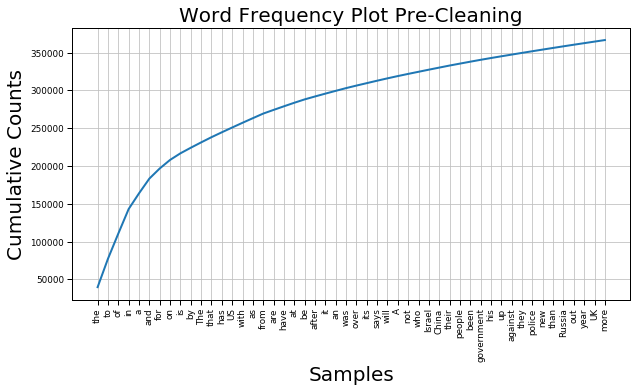

<Figure size 432x288 with 0 Axes>

In [18]:
plt.figure(figsize=(10, 5))
plt.title("Word Frequency Plot Pre-Cleaning")
fdist.plot(50, cumulative=True)

Alright so it looks like a lot of things that would be considered stop words in English are prevailing as the top words here. Another issue I'm seeing is that I didn't lowercase everything before performing these analysis, so `a` and `A` are both in this frequency distribution plot even though their the same word. Lets take care of both the casing issue and the stop words issue and then redo this displot as an example of why doing these things are important. Let's first examing just the stopwords issue:

In [19]:
en_stops = set(stopwords.words('english'))
all_headlines_no_stopwords = ""
for word in all_headlines.split():
    if word not in en_stops:
        all_headlines_no_stopwords += word + " "
all_headlines_no_stopwords

'A 117 year old woman Mexico City finally received birth certificate died hours later Trinidad Alvarez Lira waited years proof born 1898 IMF chief backs Athens permanent Olympic host The president France says Brexit Donald Trump British Man Who Must Give Police 24 Hours Notice Sex Threatens Hunger Strike The man subject sexual risk order despite never convicted crime 100 Nobel laureates urge Greenpeace stop opposing GMOs Brazil Huge spike number police killings Rio ahead Olympics Austrias highest court annuls presidential election narrowly lost right wing candidate Facebook wins privacy case track Belgian wants Doesnt matter Internet users logged Facebook Switzerland denies Muslim girls citizenship refuse swim boys school The 12 14 year old longer considered naturalised citizenship complied school curriculum authorities Basel said China kills millions innocent meditators organs report finds France Cracks Down Factory Farms A viral video campaign moved govt act In footage shared widely 

I'm already seeing issues with the approach of not lowercasing words before removing stop words as I still see instances of the word `A` and `If`, which both should've been removed. Since I'm doing this out of curiousity and for learning purposes I'll continue with creating the frequency distribution plot, but this is very valuable information:

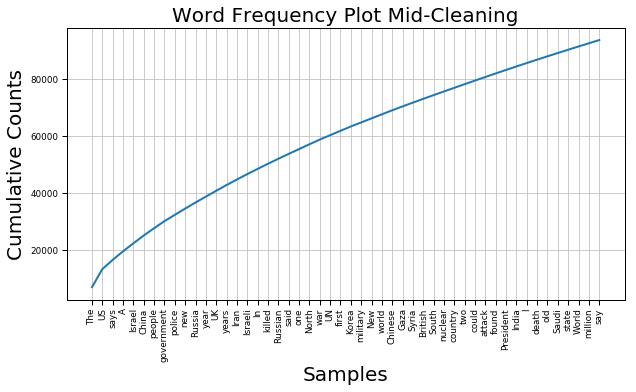

<Figure size 432x288 with 0 Axes>

In [20]:
fdist2 = FreqDist(all_headlines_no_stopwords.split())
plt.figure(figsize=(10, 5))
plt.title("Word Frequency Plot Mid-Cleaning")
fdist2.plot(50, cumulative=True)

Very interesting! As expeced, a lot less stop words are showing up, but the words `The` and `A`, which are clearly stop words not removed due to these being capitalized, still account for 2 of the top 4 most common words here indicating why it's so important to remove stop words as this is even with the lower case versions of these removed! Now lets lowercase everything and then remove stopwords, which is what I should've done in the first place, and see what we're left with:

In [21]:
all_headlines_lower = all_headlines.lower()
all_headlines_lower_no_stopwords = ""
for word in all_headlines_lower.split():
    if word not in en_stops:
        all_headlines_lower_no_stopwords += word + " "
all_headlines_lower_no_stopwords

'117 year old woman mexico city finally received birth certificate died hours later trinidad alvarez lira waited years proof born 1898 imf chief backs athens permanent olympic host president france says brexit donald trump british man must give police 24 hours notice sex threatens hunger strike man subject sexual risk order despite never convicted crime 100 nobel laureates urge greenpeace stop opposing gmos brazil huge spike number police killings rio ahead olympics austrias highest court annuls presidential election narrowly lost right wing candidate facebook wins privacy case track belgian wants doesnt matter internet users logged facebook switzerland denies muslim girls citizenship refuse swim boys school 12 14 year old longer considered naturalised citizenship complied school curriculum authorities basel said china kills millions innocent meditators organs report finds france cracks factory farms viral video campaign moved govt act footage shared widely online animals writhe pain b

Great I can already tell that there are many less stop words in here as I don't see any instances of `A`, `The` or `If` like I did last time. Now let's create our frequency distribution plot:

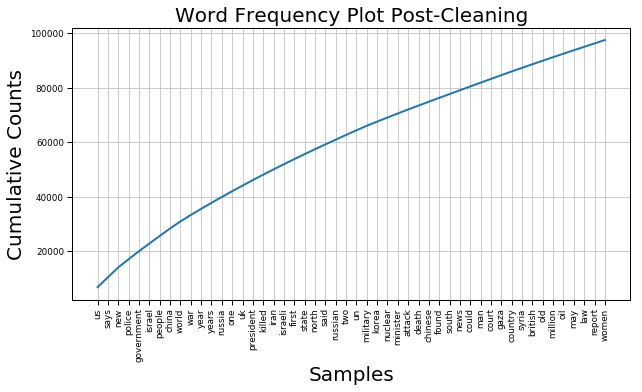

<Figure size 432x288 with 0 Axes>

In [22]:
fdist3 = FreqDist(all_headlines_lower_no_stopwords.split())
plt.figure(figsize=(10, 5))
plt.title("Word Frequency Plot Post-Cleaning")
fdist3.plot(50, cumulative=True)

That's a lot more like it! Now the most popular item is `us`, which indicates that the united states is talked about frequently in these news headlines. Other top words are `says`, `new`, `police`, and `government` which indicates to me that oftentimes headlines are telling us something about what someone or something said, about new things, and about institutions like police and government. Very interesting!

Now I need to apply this lowercasing and stop word removal to each of the headline related columns in my datasets. Let's take care of that now with a UDF that I can apply to each of the columns of my datasets instead of having to apply lower casing and stop word removal to each column separately: 

In [23]:
def rm_stopwords(item):
    cleaned = ""
    temp = item.split()
    for word in temp:
        if word not in en_stops:
            cleaned += word + " "
    return cleaned


def rm_digits(item):
    cleaned = ""
    temp = item.split()
    for word in temp:
        if not word.isdigit():
            cleaned += word + " "
    return cleaned


def lowercase_rm_stopwords_and_digits(col):
    temp = col.str.lower()
    temp = temp.apply(rm_stopwords)
    temp = temp.apply(rm_digits)
    return temp

headlines_df['News_cleaned'] = lowercase_rm_stopwords_and_digits(headlines_df["News"])
headlines_df.head()

,Date,News,tokenized,News_cleaned
0,2016-07-01,A 117 year old woman in Mexico City finally re...,"[A, 117, year, old, woman, in, Mexico, City, f...",year old woman mexico city finally received bi...
1,2016-07-01,IMF chief backs Athens as permanent Olympic host,"[IMF, chief, backs, Athens, as, permanent, Oly...",imf chief backs athens permanent olympic host
2,2016-07-01,The president of France says if Brexit won so ...,"[The, president, of, France, says, if, Brexit,...",president france says brexit donald trump
3,2016-07-01,British Man Who Must Give Police 24 Hours Noti...,"[British, Man, Who, Must, Give, Police, 24, Ho...",british man must give police hours notice sex ...
4,2016-07-01,100 Nobel laureates urge Greenpeace to stop op...,"[100, Nobel, laureates, urge, Greenpeace, to, ...",nobel laureates urge greenpeace stop opposing ...


Looking good! Now let's do this same thing to the headlines columns `combined_df` dataset:

In [24]:
for col in list(combined_df.columns)[2:]:
    if col.endswith("_tokenized"):
        break
    combined_df[col + "_cleaned"] = lowercase_rm_stopwords_and_digits(combined_df[col])
combined_df.head()

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16_cleaned,Top17_cleaned,Top18_cleaned,Top19_cleaned,Top20_cleaned,Top21_cleaned,Top22_cleaned,Top23_cleaned,Top24_cleaned,Top25_cleaned
0,2008-08-08,0,Georgia downs two Russian warplanes as countri...,BREAKING Musharraf to be impeached,Russia Today Columns of troops roll into South...,Russian tanks are moving towards the capital o...,Afghan children raped with impunity UN officia...,150 Russian tanks have entered South Ossetia w...,Breaking Georgia invades South Ossetia Russia ...,The enemy combatent trials are nothing but a s...,...,georgia invades south ossetia russia gets invo...,al qaeda faces islamist backlash,condoleezza rice us would act prevent israeli ...,busy day european union approved new sanctions...,georgia withdraw soldiers iraq help fight russ...,pentagon thinks attacking iran bad idea us new...,caucasus crisis georgia invades south ossetia,indian shoe manufactory series like work,visitors suffering mental illnesses banned oly...,help mexicos kidnapping surge
1,2008-08-11,1,Why wont America and Nato help us If they wont...,Bush puts foot down on Georgian conflict,Jewish Georgian minister Thanks to Israeli tra...,Georgian army flees in disarray as Russians ad...,Olympic opening ceremony fireworks faked,What were the Mossad with fraudulent New Zeala...,Russia angered by Israeli military sale to Geo...,An American citizen living in SOssetia blames ...,...,israel us behind georgian aggression,believe tv neither russian georgian much victims,riots still going montreal canada police murde...,china overtake us largest manufacturer,war south ossetia pics,israeli physicians group condemns state torture,russia beaten united states head peak oil,perhaps question georgia russia conflict,russia much better war,come trading sex food
2,2008-08-12,0,Remember that adorable 9 year old who sang at ...,Russia ends Georgia operation,If we had no sexual harassment we would have n...,Al Qaeda is losing support in Iraq because of ...,Ceasefire in Georgia Putin Outmaneuvers the West,Why Microsoft and Intel tried to kill the XO 1...,Stratfor The Russo Georgian War and the Balanc...,Im Trying to Get a Sense of This Whole Georgia...,...,us troops still georgia know georgia first place,russias response georgia right,gorbachev accuses us making serious blunder pu...,russia georgia nato cold war two,remember adorable year old led country war bas...,war georgia israeli connection,signs point us encouraging georgia invade sout...,christopher king argues us nato behind georgia...,america new mexico,bbc news asia pacific extinction man climate
3,2008-08-13,0,US refuses Israel weapons to attack Iran report,When the president ordered to attack Tskhinval...,Israel clears troops who killed Reuters camer...,Britain\s policy of being tough on drugs is po...,Body of 14 year old found in trunk Latest rans...,China has moved 10 million quake survivors int...,Bush announces Operation Get All Up In Russias...,Russian forces sink Georgian ships,...,elephants extinct,us humanitarian missions soon georgia russia h...,georgias ddos came us sources,russian convoy heads georgia violating truce,israeli defence minister us strike iran,gorbachev choice,witness russian forces head towards tbilisi br...,quarter russians blame us conflict poll,georgian president says us military take contr...,nobel laureate aleksander solzhenitsyn accuses...
4,2008-08-14,1,All the experts admit that we should legalise ...,War in South Osetia 89 pictures made by a Ru...,Swedish wrestler Ara Abrahamian throws away me...,Russia exaggerated the death toll in South Oss...,Missile That Killed 9 Inside Pakistan May Have...,Rushdie Condemns Random Houses Refusal to Publ...,Poland and US agree to missle defense deal Int...,Will the Russians conquer Tblisi Bet on it no ...,...,bank analyst forecast georgian crisis days early,georgia confict could set back russias us rela...,war caucasus much product american imperial dr...,non media ph

Awesome! Now I just need to re-tokenize these newly cleaned columns and then I feel done with cleaning up my data:

In [25]:
headlines_df['cleaned_tokenized'] = headlines_df['News_cleaned'].apply(word_tokenize)

for col in list(combined_df.columns):
    if col.endswith("cleaned"):
        combined_df[col + '_tokenized'] = combined_df[col].apply(word_tokenize)

combined_df.head()

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,...,Top16_cleaned_tokenized,Top17_cleaned_tokenized,Top18_cleaned_tokenized,Top19_cleaned_tokenized,Top20_cleaned_tokenized,Top21_cleaned_tokenized,Top22_cleaned_tokenized,Top23_cleaned_tokenized,Top24_cleaned_tokenized,Top25_cleaned_tokenized
0,2008-08-08,0,Georgia downs two Russian warplanes as countri...,BREAKING Musharraf to be impeached,Russia Today Columns of troops roll into South...,Russian tanks are moving towards the capital o...,Afghan children raped with impunity UN officia...,150 Russian tanks have entered South Ossetia w...,Breaking Georgia invades South Ossetia Russia ...,The enemy combatent trials are nothing but a s...,...,"[georgia, invades, south, ossetia, russia, get...","[al, qaeda, faces, islamist, backlash]","[condoleezza, rice, us, would, act, prevent, i...","[busy, day, european, union, approved, new, sa...","[georgia, withdraw, soldiers, iraq, help, figh...","[pentagon, thinks, attacking, iran, bad, idea,...","[caucasus, crisis, georgia, invades, south, os...","[indian, shoe, manufactory, series, like, work]","[visitors, suffering, mental, illnesses, banne...","[help, mexicos, kidnapping, surge]"
1,2008-08-11,1,Why wont America and Nato help us If they wont...,Bush puts foot down on Georgian conflict,Jewish Georgian minister Thanks to Israeli tra...,Georgian army flees in disarray as Russians ad...,Olympic opening ceremony fireworks faked,What were the Mossad with fraudulent New Zeala...,Russia angered by Israeli military sale to Geo...,An American citizen living in SOssetia blames ...,...,"[israel, us, behind, georgian, aggression]","[believe, tv, neither, russian, georgian, much...","[riots, still, going, montreal, canada, police...","[china, overtake, us, largest, manufacturer]","[war, south, ossetia, pics]","[israeli, physicians, group, condemns, state, ...","[russia, beaten, united, states, head, peak, oil]","[perhaps, question, georgia, russia, conflict]","[russia, much, better, war]","[come, trading, sex, food]"
2,2008-08-12,0,Remember that adorable 9 year old who sang at ...,Russia ends Georgia operation,If we had no sexual harassment we would have n...,Al Qaeda is losing support in Iraq because of ...,Ceasefire in Georgia Putin Outmaneuvers the West,Why Microsoft and Intel tried to kill the XO 1...,Stratfor The Russo Georgian War and the Balanc...,Im Trying to Get a Sense of This Whole Georgia...,...,"[us, troops, still, georgia, know, georgia, fi...","[russias, response, georgia, right]","[gorbachev, accuses, us, making, serious, blun...","[russia, georgia, nato, cold, war, two]","[remember, adorable, year, old, led, country, ...","[war, georgia, israeli, connection]","[signs, point, us, encouraging, georgia, invad...","[christopher, king, argues, us, nato, behind, ...","[america, new, mexico]","[bbc, news, asia, pacific, extinction, man, cl..."
3,2008-08-13,0,US refuses Israel weapons to attack Iran report,When the president ordered to attack Tskhinval...,Israel clears troops who killed Reuters camer...,Britain\s policy of being tough on drugs is po...,Body of 14 year old found in trunk Latest rans...,China has moved 10 million quake survivors int...,Bush announces Operation Get All Up In Russias...,Russian forces sink Georgian ships,...,"[elephants, extinct]","[us, humanitarian, missions, soon, georgia, ru...","[georgias, ddos, came, us, sources]","[russian, convoy, heads, georgia, violating, t...","[israeli, defence, minister, us, strike, iran]","[gorbachev, choice]","[witness, russian, forces, head, towards, tbil...","[quarter, russians, blame, us, conflict, poll]","[georgian, president, says, us, military, take...","[nobel, laureate, aleksander, solzhenitsyn, ac..."
4,2008-08-14,1,All the experts admit that we should legalise ...,War in South Osetia 89 pictures made by a Ru...,Swedish wrestler Ara Abrahamian throws away me...,Russia exaggerated the death toll in South Oss...,Missile That Killed 9 Inside Pakistan May Have...,Rushdie Con

Perfect! Now that all of my headlines data have been cleaned of punctuation and stop words it's time to check and see if there are any other things I need to clean up, such as null values in any of my datasets:

In [26]:
print("headlines_df: ")
display(headlines_df.info())
print("DJIA_df: ")
display(DJIA_df.info())
print("combined_df: ")
# need to set verbose and null_counts to true in order to actually see null counts since so many columns
display(combined_df.info(verbose = True, null_counts = True))

headlines_df: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73608 entries, 0 to 73607
Data columns (total 5 columns):
Date                 73608 non-null object
News                 73608 non-null object
tokenized            73608 non-null object
News_cleaned         73608 non-null object
cleaned_tokenized    73608 non-null object
dtypes: object(5)
memory usage: 2.8+ MB


None

DJIA_df: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1989 entries, 0 to 1988
Data columns (total 7 columns):
Date         1989 non-null object
Open         1989 non-null float64
High         1989 non-null float64
Low          1989 non-null float64
Close        1989 non-null float64
Volume       1989 non-null int64
Adj Close    1989 non-null float64
dtypes: float64(5), int64(1), object(1)
memory usage: 108.9+ KB


None

combined_df: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1989 entries, 0 to 1988
Data columns (total 102 columns):
Date                       1989 non-null object
Label                      1989 non-null int64
Top1                       1989 non-null object
Top2                       1989 non-null object
Top3                       1989 non-null object
Top4                       1989 non-null object
Top5                       1989 non-null object
Top6                       1989 non-null object
Top7                       1989 non-null object
Top8                       1989 non-null object
Top9                       1989 non-null object
Top10                      1989 non-null object
Top11                      1989 non-null object
Top12                      1989 non-null object
Top13                      1989 non-null object
Top14                      1989 non-null object
Top15                      1989 non-null object
Top16                      1989 non-null object
Top17          

None

According to the outputs above, every column in every dataset consists of entirely non-null values, so there is no cleaning to be done in terms of null or missing values. 

One issue I'm seeing, though, is that all of the `Date` columns are showing up as type `object` rather than a datetime object. I want these to be true datetime objects to facilitate time series analysis down the line, so I will now cast these to a true datetime object:

In [27]:
# set format string since all have same format
date_format = "%Y-%m-%d"
# use pd.to_datetime to convert strings to datetime objects
headlines_df['Date'] = pd.to_datetime(headlines_df['Date'], format = date_format)
combined_df['Date'] = pd.to_datetime(combined_df['Date'], format = date_format)
DJIA_df['Date'] = pd.to_datetime(DJIA_df['Date'], format = date_format)

print("headlines_df: ")
display(str(headlines_df['Date'].dtype))
print("DJIA_df: ")
display(str(DJIA_df['Date'].dtype))
print("combined_df: ")
display(str(combined_df['Date'].dtype))

headlines_df: 


'datetime64[ns]'

DJIA_df: 


'datetime64[ns]'

combined_df: 


'datetime64[ns]'

In [28]:
display(headlines_df.info())
display(DJIA_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73608 entries, 0 to 73607
Data columns (total 5 columns):
Date                 73608 non-null datetime64[ns]
News                 73608 non-null object
tokenized            73608 non-null object
News_cleaned         73608 non-null object
cleaned_tokenized    73608 non-null object
dtypes: datetime64[ns](1), object(4)
memory usage: 2.8+ MB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1989 entries, 0 to 1988
Data columns (total 7 columns):
Date         1989 non-null datetime64[ns]
Open         1989 non-null float64
High         1989 non-null float64
Low          1989 non-null float64
Close        1989 non-null float64
Volume       1989 non-null int64
Adj Close    1989 non-null float64
dtypes: datetime64[ns](1), float64(5), int64(1)
memory usage: 108.9 KB


None

Awesome that was easy enough! All of my other data types look exactly as I would expect them to, `datetime64` for Date columns, `object` AKA `String` for headline columns, `float64` for stock value columns, and `int64` for the boolean column as well as volume column.

And with that my data is cleaned! Now I can move on to Exploratory Data Analysis where I will get more comfortable with my data, identify trends, and get a better idea of what to do for my models down the line. I will do all of this in a separate notebook to try to keep the size of these notebooks reasonable. As a final step, I will write out the dataframes I've created so far to new files so that I can simply read them into my EDA notebook and pick up where I left off.

In [29]:
DJIA_df.to_csv("data/cleaned/DJIA.csv", index = False)
combined_df.to_csv("data/cleaned/combined.csv", index = False)
headlines_df.to_csv("data/cleaned/headlines.csv", index = False)